<a href="https://colab.research.google.com/github/VanniaMWD/vannia-hnatiuk-webDev-Portfolio/blob/main/capstone_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="light-bulb.png" alt="Flowers in Chania" style="float:left;width:100px;height:100px;">
<center><h1 style="color:#B40404;">Electric Power Generation prediction in Canada</h1></center>

<h5 style="color:#585858;">Author: Vannia Hnatiuk</h5>
<h5 style="color:#585858;">Date: April 4<sup>th</sup>, 2022</h5>

[1. Background](#one)<br>
    [1.1 About the data](#one-one)<br>
    [1.2 Canada](#one-two)<br>
[2. Exploratory Data Analysis](#two) <br>
    [2.1 Descriptive Statistics](#two-one)<br>
    [2.2 System Representation](#two-two)<br>
    [2.3 Cleaning](#two-three)<br>
    [2.4 Stationarity](#two-four)<br>
    [2.5 Trend Decomposition](#two-five)<br>
[3. Modeling](#three)<br>
    [3.1 ARIMA on seasonal difference](#three-one)<br>
    [3.2 ARIMA on original data](#three-two)<br>
    [3.3 ARIMA on logarithmic transformed data](#three-three)<br>
    [3.3 Facebook Prophet](#three-three)<br>
[4. Insights](#four)<br>
[5. References](#five)<br>

<center ><h2><a style="color:#B40404;" id='one'> Background</a></h2></center>

<p style="text-align:justified;">Energy is one of the basic human needs. A country needs electricity for manufacturing, economy and information technology. For this reason, it will be essential to unveil how much electricity Canada produce and sell to other countries. Currently, fossil fuels generate most of the power supply in the country.
Business Case: How much expensive will be to consume/produce electricity? How much will cost to produce electricity? Industry and Businesses must know how much capital to allocate for energy consumption for their production. Equally important, they can determine the cost of their products or services.</p>


<a href=https://open.canada.ca/data/en/dataset/4065fbe9-45a0-4247-912e-662cf0f8bce3>Reference </a><br>
<a href='https://www23.statcan.gc.ca/imdb/p2SV.pl?Function=getSurvey&Id=1372600'>2nd Reference</a>

Importing the necessary library to perform the analysis

In [1]:
from google.colab import files
files.upload()

Saving electric_power_stats.csv to electric_power_stats (1).csv


{'electric_power_stats.csv': b'\xef\xbb\xbf"REF_DATE","GEO","DGUID","Electric power, components","UOM","UOM_ID","SCALAR_FACTOR","SCALAR_ID","VECTOR","COORDINATE","VALUE","STATUS","SYMBOL","TERMINATED","DECIMALS"\n"1950-01","Canada","","Overall total generation","Megawatt hours","210","units ","0","v222432","1.117","4081000","","","","0"\n"1950-01","Canada","","Total utility generation","Megawatt hours","210","units ","0","v222421","1.106","3887000","","","","0"\n"1950-01","Canada","","Total hydro generation","Megawatt hours","210","units ","0","v222427","1.112","3911000","","","","0"\n"1950-01","Canada","","Total available","Megawatt hours","210","units ","0","v222441","1.130","3953000","","","","0"\n"1950-02","Canada","","Overall total generation","Megawatt hours","210","units ","0","v222432","1.117","3780000","","","","0"\n"1950-02","Canada","","Total utility generation","Megawatt hours","210","units ","0","v222421","1.106","3553000","","","","0"\n"1950-02","Canada","","Total hydro g

In [2]:
import numpy as np
import pandas as pd

# plotting
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import seaborn as sns

# stats
from statsmodels.api import tsa # time series analysis
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import month_plot
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

#sklearn
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_absolute_error

#Facebook Prophet
from fbprophet import Prophet
from fbprophet.diagnostics import performance_metrics
from fbprophet.diagnostics import cross_validation

#new pandas index
from pandas import Int64Index as NumericIndex

<h3> <a style="color:#B40404;" id='one-one'>About the data</a></h3>

<p style="text-align:justified;"> This <span style="color:#B40404;">.csv</span> file were obtained from the government's of Canada Open Data Portal. This table contains 347 series, with data for years 1950 - 2007 (not all combinations necessarily have data for all years), and is no longer being released. This table contains data described by the following dimensions (Not all combinations are available): Geography (15 items: Canada;Newfoundland and Labrador;Prince Edward Island;Nova Scotia; ...); Electric power, components (33 items: Overall total generation;Total utility generation;Total industrial generation;Total hydro generation; ...). </p><br>
<ul>
<li>
<a href=https://open.canada.ca/data/en/dataset/4065fbe9-45a0-4247-912e-662cf0f8bce3>Reference </a> </li>
<li><a href='https://www23.statcan.gc.ca/imdb/p2SV.pl?Function=getSurvey&Id=1372600'>2nd Reference</a></li>
</ul>

<p>Importing the <span style="color:#B40404;">.csv</span> file and directly formatting the <span style="color:#B40404;">'REF_DATE'</span> column due to this analysis is going to be through a <b>Time Series</b> modeling.

In [3]:
electric_power_stats=pd.read_csv('electric_power_stats.csv', parse_dates=['REF_DATE'])
electric_power_stats.head()

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning: Columns (11,12) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,REF_DATE,GEO,DGUID,"Electric power, components",UOM,UOM_ID,SCALAR_FACTOR,SCALAR_ID,VECTOR,COORDINATE,VALUE,STATUS,SYMBOL,TERMINATED,DECIMALS
0,1950-01-01,Canada,NaN,Overall total generation,Megawatt hours,210,units,0,v222432,1.117,4081000.0,NaN,NaN,NaN,0
1,1950-01-01,Canada,NaN,Total utility generation,Megawatt hours,210,units,0,v222421,1.106,3887000.0,NaN,NaN,NaN,0
2,1950-01-01,Canada,NaN,Total hydro generation,Megawatt hours,210,units,0,v222427,1.112,3911000.0,NaN,NaN,NaN,0
3,1950-01-01,Canada,NaN,Total available,Megawatt hours,210,units,0,v222441,1.130,3953000.0,NaN,NaN,NaN,0
4,1950-02-01,Canada,NaN,Overall total generation,Megawatt hours,210,units,0,v222432,1.117,3780000.0,NaN,NaN,NaN,0


Inspecting the structure of this dataset:
<ul>
<li>This dataset has 120,927 observations</li>
<li>15 features</li>
<li>Null values in 'VALUE', 'STATUS' and 'SYMBOL' columns</li>
<li>There is a mix of datatypes: datetime, object, int and float datatypes</li>
</li>

In [4]:
electric_power_stats.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120927 entries, 0 to 120926
Data columns (total 15 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   REF_DATE                    120927 non-null  datetime64[ns]
 1   GEO                         120927 non-null  object        
 2   DGUID                       0 non-null       float64       
 3   Electric power, components  120927 non-null  object        
 4   UOM                         120927 non-null  object        
 5   UOM_ID                      120927 non-null  int64         
 6   SCALAR_FACTOR               120927 non-null  object        
 7   SCALAR_ID                   120927 non-null  int64         
 8   VECTOR                      120927 non-null  object        
 9   COORDINATE                  120927 non-null  float64       
 10  VALUE                       119749 non-null  float64       
 11  STATUS                      1178 non-nu

<p>A fundamental step for a Time Series Analysis is to assign the 'date' column as an index of the dataframe</p>

In [5]:
electric_power_stats = electric_power_stats.set_index('REF_DATE')
electric_power_stats.head()

,GEO,DGUID,"Electric power, components",UOM,UOM_ID,SCALAR_FACTOR,SCALAR_ID,VECTOR,COORDINATE,VALUE,STATUS,SYMBOL,TERMINATED,DECIMALS
REF_DATE,,,,,,,,,,,,,,
1950-01-01,Canada,NaN,Overall total generation,Megawatt hours,210,units,0,v222432,1.117,4081000.0,NaN,NaN,NaN,0
1950-01-01,Canada,NaN,Total utility generation,Megawatt hours,210,units,0,v222421,1.106,3887000.0,NaN,NaN,NaN,0
1950-01-01,Canada,NaN,Total hydro generation,Megawatt hours,210,units,0,v222427,1.112,3911000.0,NaN,NaN,NaN,0
1950-01-01,Canada,NaN,Total available,Megawatt hours,210,units,0,v222441,1.130,3953000.0,NaN,NaN,NaN,0
1950-02-01,Canada,NaN,Overall total generation,Megawatt hours,210,units,0,v222432,1.117,3780000.0,NaN,NaN,NaN,0


<p>Let's proceed to do an initial elimation of non relevant features for the analysis</p>

In [6]:
non_relevant_columns=['DGUID','UOM_ID','SCALAR_FACTOR',
                        'SCALAR_ID','VECTOR','COORDINATE',
                        'STATUS','SYMBOL','TERMINATED','DECIMALS']

In [7]:
electric_power_stats.drop(non_relevant_columns,axis=1,inplace=True)

First Dataframe version

In [8]:
electric_power_stats.head()

,GEO,"Electric power, components",UOM,VALUE
REF_DATE,,,,
1950-01-01,Canada,Overall total generation,Megawatt hours,4081000.0
1950-01-01,Canada,Total utility generation,Megawatt hours,3887000.0
1950-01-01,Canada,Total hydro generation,Megawatt hours,3911000.0
1950-01-01,Canada,Total available,Megawatt hours,3953000.0
1950-02-01,Canada,Overall total generation,Megawatt hours,3780000.0


Reordening columns according to relevance

In [9]:
electric_power_stats=electric_power_stats[['VALUE','UOM','Electric power, components','GEO']]
electric_power_stats

,VALUE,UOM,"Electric power, components",GEO
REF_DATE,,,,
1950-01-01,4081000.0,Megawatt hours,Overall total generation,Canada
1950-01-01,3887000.0,Megawatt hours,Total utility generation,Canada
1950-01-01,3911000.0,Megawatt hours,Total hydro generation,Canada
1950-01-01,3953000.0,Megawatt hours,Total available,Canada
1950-02-01,3780000.0,Megawatt hours,Overall total generation,Canada
...,...,...,...,...
2007-12-01,0.0,Megawatt hours,Industrial internal combustion generation,Nunavut
2007-12-01,0.0,Megawatt hours,Total combustion turbine generation,Nunavut
2007-12-01,0.0,Megawatt hours,Utility combustion turbine generation,Nunavut


<h2><a style="color:#B40404;" id='one-two'>Canada</a> </h2>

<p>This analysis will be performed on a National basis. Hence, this dataframe will be fragmented with the selection of <span style="color:#B40404;">'GEO' </span> with 'Canada' instead of the provinces.

In [10]:
canada=electric_power_stats[electric_power_stats['GEO'] == 'Canada']
canada

,VALUE,UOM,"Electric power, components",GEO
REF_DATE,,,,
1950-01-01,4081000.0,Megawatt hours,Overall total generation,Canada
1950-01-01,3887000.0,Megawatt hours,Total utility generation,Canada
1950-01-01,3911000.0,Megawatt hours,Total hydro generation,Canada
1950-01-01,3953000.0,Megawatt hours,Total available,Canada
1950-02-01,3780000.0,Megawatt hours,Overall total generation,Canada
...,...,...,...,...
2007-12-01,2621615.0,Megawatt hours,Total non-firm deliveries,Canada
2007-12-01,2621615.0,Megawatt hours,Non-firm deliveries to the United States,Canada
2007-12-01,-497033.0,Megawatt hours,Total other deliveries,Canada


Currently, the analysis will be executed on the total of electricity generated from all sources. 

In [11]:
canada=canada[canada['Electric power, components'] == 'Overall total generation']
canada

,VALUE,UOM,"Electric power, components",GEO
REF_DATE,,,,
1950-01-01,4081000.0,Megawatt hours,Overall total generation,Canada
1950-02-01,3780000.0,Megawatt hours,Overall total generation,Canada
1950-03-01,4186000.0,Megawatt hours,Overall total generation,Canada
1950-04-01,4070000.0,Megawatt hours,Overall total generation,Canada
1950-05-01,4425000.0,Megawatt hours,Overall total generation,Canada
...,...,...,...,...
2007-08-01,48161855.0,Megawatt hours,Overall total generation,Canada
2007-09-01,42731316.0,Megawatt hours,Overall total generation,Canada
2007-10-01,46575984.0,Megawatt hours,Overall total generation,Canada


Structure of the dataframe that will be analysed 

In [12]:
canada.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 696 entries, 1950-01-01 to 2007-12-01
Data columns (total 4 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   VALUE                       696 non-null    float64
 1   UOM                         696 non-null    object 
 2   Electric power, components  696 non-null    object 
 3   GEO                         696 non-null    object 
dtypes: float64(1), object(3)
memory usage: 27.2+ KB


<center><h2><a style="color:#B40404;" id='two'>Exploratory Data Analysis</a></h2></center>

The target observation will be 'VALUE'. This feature is the Power Electricity scaled in Mega Watt-Hour. Electric Power is the rate at which electrical energy is produced. It is calculated using the following equation:<br>
$$P = IV $$
Where:<br>
P=Power in Watts <br>
I=current in Ampers <br>
V=Voltage in Volts <br>

<q>A megawatt is a unit for measuring power that is equivalent to one million watts.  One megawatt is equivalent to the energy produced by 10 automobile engines.
A megawatt hour (Mwh) is equal to 1,000 Kilowatt hours (Kwh).  It is equal to 1,000 kilowatts of electricity used continuously for one hour.  It is about equivalent to the amount of electricity used by about 330 homes during one hour.</q>
<a href='https://www.cleanenergyauthority.com/solar-energy-resources/what-is-a-megawatt-and-a-megawatt-hour'> Reference</a><br>

<h3><a style="color:#B40404;" id='two-one'><u>Descriptive Statistics</u></a></h3>

Before to start with the analysis, a brief exploration of the distribution of the generated over the decades will be explored: 

In [13]:
canada['VALUE'].describe()

count    6.960000e+02
mean     2.751151e+07
std      1.606715e+07
min      3.780000e+06
25%      1.084500e+07
50%      2.754751e+07
75%      4.229691e+07
max      5.866012e+07
Name: VALUE, dtype: float64

In [14]:
fig = px.scatter(canada, x=canada.index , y='VALUE',
                title='Distribution of Electricity Generation from 1950-2007',
                labels={
                        "REF_DATE":'Decade',
                        "VALUE":'Megawatt-Hour'
                        },
                template='ggplot2'                
                )
fig.show()

Since 1950 the power generation increased in a double rate for two decades. However, this rate slowed down to 1.3x from 1970 to 2000, certainly for the amount scalation of electricity production. The most noticeable plateau ocurred from the 1990 to 2000 decade, where the electricity increased from 46 millions of mwh to 57.27 millions of mwh at a 1.10 rate. Moreover, the last observed trend is from 2000 with 48.43 millions mwh to 57.33 mwh in 2007 at 1.18 rate.
The first record in 1950 showed a generation of 4.081 of millions of Meggawatt-hour, later in 1960 increased to 9.44 millions of Meggawatts. 


<h1 style="color:#A901DB">To do: </h1>
<ol>
<li> Introduce the motivation to perform the decomposition of the power generation curve</li>
<li> Insert the information from the O'Reilly time series slides</li>
<li> Add Explannation of the graphs</li>
<li> Tune Facebook Prophet model: change to multiplicative trend</li>
<li> Transform seasonality component</li>
<li> Make decrease variance</li>
</ol>


<h4 style="color:#B40404;">System Representation</h4>

In [15]:
# add lines for each column
fig = px.line(canada, x=canada.index, y=canada['VALUE'],)

# axis labels and title
fig.update_layout(
    yaxis_title="Megawatt-hour", 
    legend_title="Power", 
    title="Power Generation over time",
)

# activate slider
fig.update_xaxes(rangeslider_visible=True)

fig.show()

<p>The Electricity generation is defined by an Upstream Trend, when year by year: more electricity is being generated. The seasonality exhibits peaks in winter months (from November to January). This is because in winther months: days are shorter and cooler. For this reason the production tries to fulfill this demand for ilumination and heating. 
Later, the generation starts to decline into warmer months when ilumination and heating is less required. Up to a slight peak in July and August when temperature rises and more electricity is required for cooling systems. Cooling systems appliances consume immense loads of power. Equally important,the distance between peaks and valleys fluctuates year by year showing an increasing variance.</p>

To know the time span its used the <span style="color:#B40404;">.min()</span> and <span style="color:#B40404;">.max()</span>

In [16]:
first_year = canada.index.min()
last_year = canada.index.max()

# pandas `Timestamp` objects
first_year, last_year

(Timestamp('1950-01-01 00:00:00'), Timestamp('2007-12-01 00:00:00'))

<h4 style="color:#515A5A;font-weight;bold"><i>Observing Monthly seasonality</i></h4>

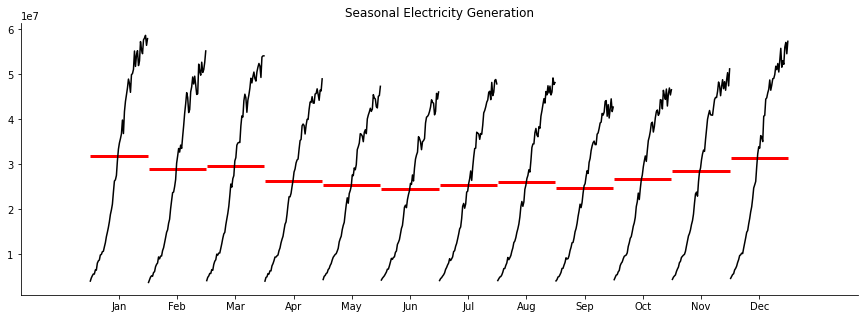

In [17]:
plt.figure(figsize=(15, 5))

# create the seasonal plot
month_plot(canada["VALUE"], ax=plt.gca())

plt.title("Seasonal Electricity Generation")
sns.despine()
plt.show()

This graph is a magnified perspective of the seasonality in the previous wave. The peak of months with highest electricity production occurs in winter months (December-March) when days are shorter and cooler. For this reason, the electricity generation tries to fulfill the demand for heating and illumination. As temperatures rises, the generation descreases with some little peaks in July and August.

<h3><a style="color:#B40404;" id='two-three'><u>Data Cleaning</a></u></h3>

<h4 style="color:#515A5A;font-weight;bold"><i>Looking for null values</i></h3>

In [18]:
full_range = pd.date_range(start=first_year, end=last_year, freq="AS")

full_range.difference(canada.index)

DatetimeIndex([], dtype='datetime64[ns]', freq=None)

There were not found null values in this time span. 

<h3><a style="color:#B40404;" id='two-one'><u>Stationarity</ul></h3>

In [19]:
can_plain=canada[['VALUE']].copy()
can_plain.head()

,VALUE
REF_DATE,
1950-01-01,4081000.0
1950-02-01,3780000.0
1950-03-01,4186000.0
1950-04-01,4070000.0
1950-05-01,4425000.0


An initial step is to determine that the time series are stationary. This is because once a system is stationary it will be possible that previous pattern can forecast a trend in the future. A time series to be stationary needs that its mean, variance and covariance are independent of time. The next step is to look if this series are self correlated and found its internal dynamics. 


<h4 style="color:#B40404;"> Augmented Dickey-Fuller test</h4>
Performing Augmented Dickey-Fuller test to determine the presence of a unit root in the series 

Null Hypothesis: The series has a unit root.

Alternate Hypothesis: The series has no unit root.

If the null hypothesis in failed to be rejected, this test may provide evidence that the series is non-stationary.

<a href='https://www.statsmodels.org/devel/examples/notebooks/generated/stationarity_detrending_adf_kpss.html'>Reference</a>

In [20]:
adf, pvalue, critical, results = sm.tsa.stattools.adfuller(can_plain['VALUE'], regresults=True)

In [21]:
print(adf, pvalue)

-0.25516401692848617 0.9316187748520499


The Augmented Dickey-Fuller test, returned that there is a unit root is present in this signal. Because the p value is higher than the threshold. This leads to accept the Null hypothesis that <span style="color:#B40404;">there is an unit root </span>in this series. As a result the series is <span style="color:#B40404;font-weight:bold"> not stationary </span>. An unit root is a source of nonstationarity.

<h4 style="color:#B40404;"> KPSS test</h4>

KPSS is another test for checking the stationarity of a time series. The null and alternate hypothesis for the KPSS test are opposite that of the ADF test.

Null Hypothesis: The process is trend stationary.

Alternate Hypothesis: The series has a unit root (series is not stationary).



In [23]:
sm.tsa.stattools.kpss(can_plain['VALUE'], regression='ct', nlags='auto', store=False)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:2019: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




(0.622107264264051,
 0.01,
 12,
 {'1%': 0.216, '10%': 0.119, '2.5%': 0.176, '5%': 0.146})

Because the <span style="color:#B40404;"> p-value </span> is  <span style="color:#B40404;">0.01</span>. Since this value is less than .05, we are able to reject the null hypothesis of the KPSS test. For this reason, the time series trend is <span style="color:#B40404;font-weight:bold">not stationary</span>.

<h3><a style="color:#B40404;" id='two-four'><u>Trend Decomposition</a></u></h3>

In order to obtain a stationary curve, it is necessary to perform a trend-seasonal decomposition where we can obtain:
- a trend component $T_t$ calculated using a moving average,
- a seasonal component $S_t$ which is the monthly/daily average of the de-trended series, and
- the residual $R_t$ that remains after subtracting the trend and seasonal component from the original series.

Adding up these three components will give back the original series:

$$y_t = T_t + S_t + R_t$$

This can be performed through the function <span style="color:#B40404;" > seasonal_decompose</span> from <span style="color:#B40404;"> stats_model</span>. Where the decomposition is going to be in a <span style="color:#B40404;" >multiplicative form</span>. This is because the pattern of the system shows a minimal grade of additive and great multiplicative factor.

In [24]:
decomposition = tsa.seasonal_decompose(can_plain, model='additive')

In [25]:
can_plain["Trend"] = decomposition.trend
can_plain["Seasonal"] = decomposition.seasonal
can_plain["Residual"] = decomposition.resid

can_plain.sample(10)

,VALUE,Trend,Seasonal,Residual
REF_DATE,,,,
1950-08-01,4199000.0,4.325583e+06,-1.568316e+06,1.441733e+06
1967-02-01,13734000.0,1.360425e+07,1.706670e+06,-1.576920e+06
1953-06-01,5265000.0,5.450083e+06,-2.935865e+06,2.750782e+06
1985-06-01,32077297.0,3.705009e+07,-2.935865e+06,-2.036924e+06
1968-02-01,14913000.0,1.421892e+07,1.706670e+06,-1.012587e+06
1960-11-01,9591000.0,9.473208e+06,6.438558e+05,-5.260641e+05
1975-04-01,22802000.0,2.279279e+07,-9.736631e+05,9.828714e+05
1992-01-01,50166452.0,4.143635e+07,4.884914e+06,3.845185e+06
1969-03-01,16571000.0,1.547808e+07,2.411920e+06,-1.319003e+06


In [26]:
cols = ["Trend", "Seasonal", "Residual"]

fig = make_subplots(rows=3, cols=1, subplot_titles=cols)

for i, col in enumerate(cols):
    fig.add_trace(
        go.Scatter(x=can_plain.index, y=can_plain[col]),
        row=i+1,
        col=1,
    )

fig.update_layout(height=800, width=1200, showlegend=False)
fig.show()

Interpretation of the graph:
<ul>
<li>The trend shows an increase of power generation with some dips in the year 75', 82', 90', 98', 99', 2001, 2004 and 2006. </li>
<li>The seasonal plot it shows constant seasonality and same pattern.</li>
<li>The residuals display some seasonality and fluctuating variance <span style="color:#B40404;">"heteroscedascity"</span></li>
</ul>

<center><h2><a style="color:#B40404;" id='two'>Modeling </h2></center>

In [27]:
#Yearly seasonal difference
can_plain["seasonal_difference"] = can_plain["VALUE"].diff(12)

<h3><a style="color:#B40404;" id='three-one'><u>ARIMA model on seasonal difference on a yearly basis</u></h3>

In [28]:
fig = px.line(can_plain, x=can_plain.index, y="seasonal_difference")

fig.update_layout(
    yaxis_title="Difference Megawattshour", 
    xaxis_title="Date",
    title="Seasonal Difference on yearly basis"
)

fig.show()

The seasonal Difference showed an expanded variance: however, the mean lands at 0 at the seasonal difference

In [29]:
sm.tsa.stattools.kpss(can_plain['seasonal_difference'].dropna(), regression='ct', nlags='auto', store=False)

(0.19714449609740187,
 0.017070813963474298,
 15,
 {'1%': 0.216, '10%': 0.119, '2.5%': 0.176, '5%': 0.146})

Because the <span style="color:#B40404;"> p-value </span> is  <span style="color:#B40404;">0.017</span>. Since this value is less than .05, we are able to reject the null hypothesis of the KPSS test. For this reason, the time series trend is <span style="color:#B40404;font-weight:bold">not stationary</span>.

In [30]:
can_plain['seasonal_difference']

REF_DATE
1950-01-01          NaN
1950-02-01          NaN
1950-03-01          NaN
1950-04-01          NaN
1950-05-01          NaN
                ...    
2007-08-01     408886.0
2007-09-01    1003422.0
2007-10-01    1159018.0
2007-11-01    3775622.0
2007-12-01    2763734.0
Name: seasonal_difference, Length: 696, dtype: float64

<h5 style="color:#B40404;">Splitting the dataset</h4>

The training dataset will be divided in years previous to 2000 whereas the test dataset will cover 7 years later.

In [48]:
train = can_plain.loc[can_plain.index <= "2005-12-01", "seasonal_difference"].dropna()
test = can_plain.loc[can_plain.index >= "2005-12-01", "seasonal_difference"]

In [49]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=train, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=test, mode='lines', name="Test"))
fig.update_layout(
    yaxis_title="Difference Megawatt hour", 
    xaxis_title="Date",
    title="Change in Megawatt hour over Prior Year"
)
fig.show()

Looking for autocorrelation for <span style="color:#B40404;font-size:110%;font-weight:bold"> 12</span> lags.

In [50]:
fig = px.scatter(
    x=can_plain["VALUE"], 
    y=can_plain["VALUE"].shift(12) # 12-month lagged observations, season
)
fig.update_layout(
    xaxis_title="Electricity generation on Current Year", 
    yaxis_title="Electricity Year Lagged"
)
fig.show()

<h5 style="color:#B40404;"> Autocorrelation Function</h5>

Autocorrelation in <span style="color:#B40404;font-size:100%;font-weight:bold">seasonal difference</span>.

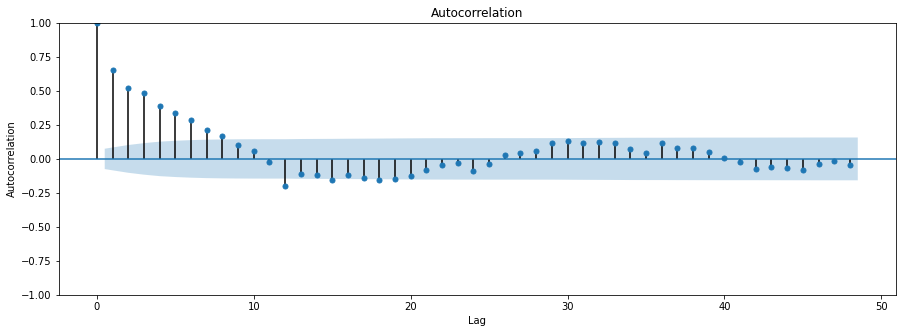

In [51]:
plt.figure(figsize=(15, 5))
plot_acf(can_plain["seasonal_difference"].dropna(), lags=48, ax=plt.gca())
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

The plot from the autocorrelation function shows <span style="color:#B40404;font-size:110%;font-weight:bold"> 8 </span> significant lags to set parameter <i style="color:#B40404;font-size:110%;font-weight:bold"> q </i> to the SARIMAX model.

<h5 style="color:#B40404;">Partial Autocorrelation</h5>

/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/tsaplots.py:353: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



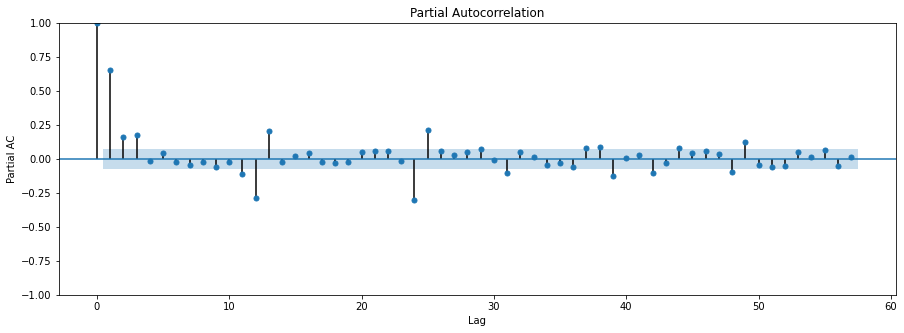

In [52]:
plt.figure(figsize=(15, 5))
plot_pacf(can_plain["seasonal_difference"].dropna(), lags=57, ax=plt.gca())
plt.xlabel('Lag')
plt.ylabel('Partial AC')
plt.show()

The plot from the partial autocorrelation function shows <span style="color:#B40404;font-size:110%;font-weight:bold">15</span> significant lags to set parameter <i style="color:#B40404;font-size:110%;font-weight:bold"> p </i> to the SARIMAX model.

<h4 style="color:#B40404;">SARIMAX model</h4>

This model used the parameters given by the plots of the autocorrelation function and the partial correlation function.

In [53]:

model = SARIMAX(train, order=(15, 1, 8), trend="ct") #Random walk: (0,1,0)
model_fit = model.fit(disp=False)

model_fit.summary()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



<class 'statsmodels.iolib.summary.Summary'>
"""
                                SARIMAX Results                                
===============================================================================
Dep. Variable:     seasonal_difference   No. Observations:                  660
Model:               SARIMAX(15, 1, 8)   Log Likelihood               -9933.089
Date:                 Tue, 29 Mar 2022   AIC                          19918.178
Time:                         03:25:43   BIC                          20034.936
Sample:                     01-01-1951   HQIC                         19963.437
                          - 12-01-2005                                         
Covariance Type:                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -2116.5756    2.2e+04     -0.096      0.923   -4.52e+04     4.1e+04
drift         30.0467     52.396      0.573      0.566     -72.648     132.741
ar.L1         -0.4224      0.182     -2.318      0.020      -0.780      -0.065
ar.L2         -0.2070      0.196     -1.058      0.290      -0.591       0.177
ar.L3          0.2394      0.177      1.355      0.176      -0.107       0.586
ar.L4         -0.2289      0.073     -3.137      0.002      -0.372      -0.086
ar.L5          0.3017      0.092      3.273      0.001       0.121       0.482
ar.L6          0.4480      0.052      8.551      0.000       0.345       0.551
ar.L7          0.5117      0.097      5.268      0.000       0.321       0.702
ar.L8         -0.1965      0.160     -1.228      0.219      -0.510       0.117
ar.L9         -0.0904      0.078     -1.154      0.248      -0.244       0.063
ar.L10        -0.0815      0.051     -1.611      0.107      -0.181       0.018
ar.L11         0.0402      0.049      0.824      0.410      -0.055       0.136
ar.L12        -0.2864      0.044     -6.555      0.000      -0.372      -0.201
ar.L13        -0.1404      0.066     -2.127      0.033      -0.270      -0.011
ar.L14        -0.1237      0.069     -1.789      0.074      -0.259       0.012
ar.L15        -0.0018      0.061     -0.030      0.976      -0.122       0.118
ma.L1          0.0151      0.177      0.085      0.932      -0.332       0.362
ma.L2         -0.1335      0.123     -1.085      0.278      -0.374       0.108
ma.L3         -0.3873      0.070     -5.538      0.000      -0.524      -0.250
ma.L4          0.3259      0.045      7.248      0.000       0.238       0.414
ma.L5         -0.4544      0.047     -9.726      0.000      -0.546      -0.363
ma.L6         -0.4779      0.061     -7.810      0.000      -0.598      -0.358
ma.L7         -0.3747      0.126     -2.977      0.003      -0.621      -0.128
ma.L8          0.6221      0.150      4.152      0.000       0.328       0.916
sigma2      7.988e+11   7.47e-07   1.07e+18      0.000    7.99e+11    7.99e+11
===================================================================================
Ljung-Box (L1) (Q):                   0.18   Jarque-Bera (JB):               240.36
Prob(Q):                              0.67   Prob(JB):                         0.00
Heteroskedasticity (H):              27.72   Skew:                            -0.16
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.94
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 5.14e+36. Standard errors may be unstable.
"""

<h5>1st prediction</h5>

In [54]:
predictions = model_fit.predict(start=0, end=len(train)+len(test)-1)

In [55]:
predictions

1951-01-01   -1.685458e+03
1951-02-01    4.817906e+05
1951-03-01    4.499230e+05
1951-04-01    6.549796e+05
1951-05-01    6.783619e+05
                  ...     
2007-09-01    1.608279e+06
2007-10-01    1.365604e+06
2007-11-01    1.467909e+06
2007-12-01    1.446369e+06
2008-01-01    1.764335e+06
Freq: MS, Name: predicted_mean, Length: 685, dtype: float64

In [56]:
predictions.index.min()

Timestamp('1951-01-01 00:00:00', freq='MS')

In [57]:
predictions.index.max()

Timestamp('2008-01-01 00:00:00', freq='MS')

In [58]:
predictions['2006':]

2006-01-01    9.522733e+05
2006-02-01    1.862620e+06
2006-03-01    8.210159e+05
2006-04-01    1.955868e+06
2006-05-01    6.470852e+05
2006-06-01   -5.682141e+05
2006-07-01    5.909924e+05
2006-08-01    4.376536e+05
2006-09-01    1.018075e+06
2006-10-01    1.165647e+06
2006-11-01    5.847811e+05
2006-12-01    1.488011e+05
2007-01-01    5.721678e+05
2007-02-01    1.073947e+06
2007-03-01    1.264522e+06
2007-04-01    1.168014e+06
2007-05-01    9.936353e+05
2007-06-01    1.042556e+06
2007-07-01    1.173235e+06
2007-08-01    1.788731e+06
2007-09-01    1.608279e+06
2007-10-01    1.365604e+06
2007-11-01    1.467909e+06
2007-12-01    1.446369e+06
2008-01-01    1.764335e+06
Freq: MS, Name: predicted_mean, dtype: float64

In [59]:
my_forecast=model_fit.forecast(steps=48)
my_forecast

2006-01-01    9.522733e+05
2006-02-01    1.862620e+06
2006-03-01    8.210159e+05
2006-04-01    1.955868e+06
2006-05-01    6.470852e+05
2006-06-01   -5.682141e+05
2006-07-01    5.909924e+05
2006-08-01    4.376536e+05
2006-09-01    1.018075e+06
2006-10-01    1.165647e+06
2006-11-01    5.847811e+05
2006-12-01    1.488011e+05
2007-01-01    5.721678e+05
2007-02-01    1.073947e+06
2007-03-01    1.264522e+06
2007-04-01    1.168014e+06
2007-05-01    9.936353e+05
2007-06-01    1.042556e+06
2007-07-01    1.173235e+06
2007-08-01    1.788731e+06
2007-09-01    1.608279e+06
2007-10-01    1.365604e+06
2007-11-01    1.467909e+06
2007-12-01    1.446369e+06
2008-01-01    1.764335e+06
2008-02-01    1.894626e+06
2008-03-01    1.728214e+06
2008-04-01    1.495236e+06
2008-05-01    1.530416e+06
2008-06-01    1.692475e+06
2008-07-01    1.807098e+06
2008-08-01    1.783536e+06
2008-09-01    1.611390e+06
2008-10-01    1.489161e+06
2008-11-01    1.528840e+06
2008-12-01    1.730628e+06
2009-01-01    1.725953e+06
2

Joining the predictions with the forecast

In [60]:
whole_prediction=pd.concat([predictions,my_forecast['2008-02-01':]],ignore_index=False)

In [61]:
whole_prediction

1951-01-01   -1.685458e+03
1951-02-01    4.817906e+05
1951-03-01    4.499230e+05
1951-04-01    6.549796e+05
1951-05-01    6.783619e+05
                  ...     
2009-08-01    1.628616e+06
2009-09-01    1.599206e+06
2009-10-01    1.660227e+06
2009-11-01    1.766782e+06
2009-12-01    1.829349e+06
Freq: MS, Name: predicted_mean, Length: 708, dtype: float64

Training dataset using the <span style="color:#B40404;font-size:150%;font-weight:bold">seasonal difference</span>

In [62]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=train, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=test, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=whole_prediction.index, y=whole_prediction, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Difference (MWH)", 
    xaxis_title="Date",
    title="Change in Electricity Generation over Prior Year"
)
fig.show()

Characterizing the SARIMAX model as a <i>random walk</i>, it exactly replicated the original seasonal difference series. Nonetheless, the prediction doesn't repeat any past pattern and it predicts a stationary trend. It needs more tunning for parameters q and p for better results.

<h5 style="color:#B40404;">Model Evaluation</h5>

In [63]:

train_mape = 100*mean_absolute_percentage_error(train, predictions[train.index])
test_mape = 100*mean_absolute_percentage_error(test, predictions[test.index])

print(f"Train MAPE on the difference: {round(train_mape, 2)}%")
print(f"Test MAPE on the difference: {round(test_mape, 2)}%")

Train MAPE on the difference: 173.01%
Test MAPE on the difference: 672.62%


In [64]:

train_MAE = mean_absolute_error(train, predictions[train.index])
test_MAE = mean_absolute_error(test, predictions[test.index])

print(f"Train MAE on the difference: {round(train_MAE, 2)}")
print(f"Test MAE on the difference: {round(test_MAE, 2)}")

Train MAE on the difference: 566156.93
Test MAE on the difference: 1520288.65


<h3><a style="color:#B40404;" id='three-two'><u>ARIMA model on original data</a></u></h3>

The training dataset will be divided in years previous to 2000 whereas the test dataset will cover 7 years later without seasonal difference and no transformation eiter. 

In [31]:
train2=can_plain.loc[:'2004','VALUE']

In [32]:
test2=can_plain.loc['2004':,'VALUE']
test2

REF_DATE
2004-01-01    58071726.0
2004-02-01    50420533.0
2004-03-01    49311591.0
2004-04-01    44234650.0
2004-05-01    42544138.0
2004-06-01    41747347.0
2004-07-01    46045442.0
2004-08-01    46070464.0
2004-09-01    42391075.0
2004-10-01    45654017.0
2004-11-01    48754118.0
2004-12-01    56046804.0
2005-01-01    58660124.0
2005-02-01    51031876.0
2005-03-01    53844989.0
2005-04-01    46504821.0
2005-05-01    45145394.0
2005-06-01    45769222.0
2005-07-01    48658569.0
2005-08-01    49206500.0
2005-09-01    44555418.0
2005-10-01    46967428.0
2005-11-01    50373952.0
2005-12-01    57092582.0
2006-01-01    56441389.0
2006-02-01    52672322.0
2006-03-01    54100224.0
2006-04-01    46323273.0
2006-05-01    45276180.0
2006-06-01    44511429.0
2006-07-01    48858918.0
2006-08-01    47752969.0
2006-09-01    41727894.0
2006-10-01    45416966.0
2006-11-01    47441533.0
2006-12-01    54574434.0
2007-01-01    57934815.0
2007-02-01    55195228.0
2007-03-01    54109989.0
2007-04-01    49

<h5 style="color:#B40404;"> Autocorrelation Function</h5>

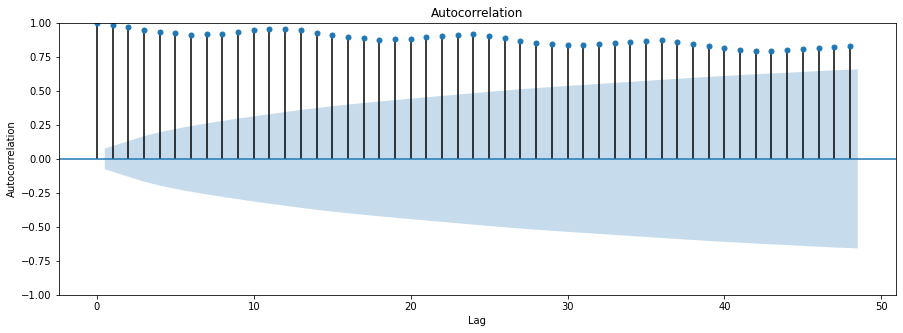

In [33]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plt.figure(figsize=(15, 5))

# put the acf plot on the current axis
plot_acf(train2, lags=48, ax=plt.gca()) #lags=58
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

The autocorrelation function points ideally to <span style="color:#B40404;font-size:110%;font-weight:bold">51-52 </span> significant lags  to set parameter <i style="color:#B40404;font-size:110%;font-weight:bold"> q </i> to the SARIMAX model. However, execution time will take long time and there is not a good trade off for forecast. For a first run on original data, 10 lags will be applied as a starter point.

<h5 style="color:#B40404;">Partial Autocorrelation</h5>

/usr/local/lib/python3.7/dist-packages/statsmodels/graphics/tsaplots.py:353: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



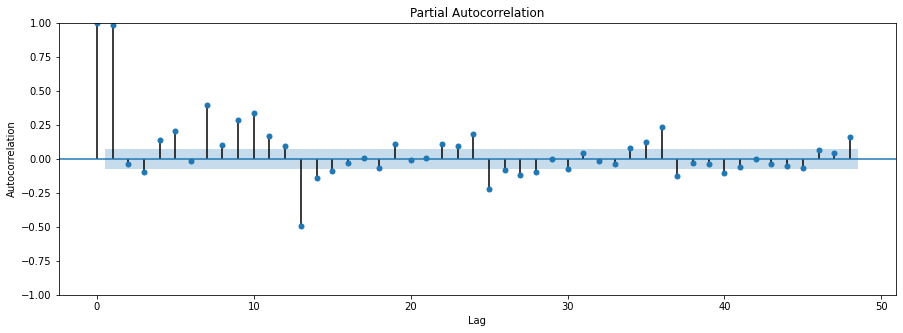

In [34]:

plt.figure(figsize=(15, 5))

# put the acf plot on the current axis
plot_pacf(train2, lags=48, ax=plt.gca()) #lags 58
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

The partial autocorrelation function indicates <span style="color:#B40404;font-size:110%;font-weight:bold">28</span> significant lags  to set parameter <i style="color:#B40404;font-size:110%;font-weight:bold"> p </i> to the SARIMAX model.

In [44]:
pip install pmdarima

     |████████████████████████████████| 1.4 MB 7.3 MB/s 
     |████████████████████████████████| 9.8 MB 18.5 MB/s 
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2


In [35]:
import pmdarima as pm

# Create auto_arima model
model1 = pm.auto_arima(train2, #time series
                    seasonal=True, # is the time series seasonal
                    m=12, # the seasonal period - one year
                    d=1, # non-seasonal difference order
                    D=1, # seasonal difference order
                    max_p=6, # max value of p to test 
                    max_q=6, # max value of p to test
                    max_P=6, # max value of P to test 
                    max_Q=6, # max value of Q to test 
                    information_criterion='aic', # used to select best mode
                    trace=True, # prints the information_criterion for each model it fits
                    error_action='ignore', # ignore orders that don't work
                    stepwise=True, # apply an intelligent order search
                    suppress_warnings=True) 

# Print model summary
print(model1.summary())


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,1,1)[12]             : AIC=19530.287, Time=5.14 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=19788.316, Time=0.06 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=19640.292, Time=0.52 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=19551.427, Time=0.67 sec
 ARIMA(2,1,2)(0,1,1)[12]             : AIC=19528.752, Time=4.39 sec
 ARIMA(2,1,2)(0,1,0)[12]             : AIC=19669.742, Time=1.23 sec
 ARIMA(2,1,2)(0,1,2)[12]             : AIC=19530.108, Time=8.81 sec
 ARIMA(2,1,2)(1,1,0)[12]             : AIC=19594.750, Time=1.43 sec
 ARIMA(2,1,2)(1,1,2)[12]             : AIC=19526.442, Time=13.55 sec
 ARIMA(2,1,2)(2,1,2)[12]             : AIC=19526.084, Time=14.26 sec
 ARIMA(2,1,2)(2,1,1)[12]             : AIC=19527.994, Time=14.88 sec
 ARIMA(2,1,2)(3,1,2)[12]             : AIC=19527.792, Time=35.46 sec
 ARIMA(2,1,2)(2,1,3)[12]             : AIC=19526.845, Time=34.98 sec
 ARIMA(2,1,2)(1,1,3)[12]             : AIC=19526.304, Time=29.18 sec

<h4 style="color:#B40404;font-weight:bold">1 <sup>st</sup> model run 

In [36]:
p_param = 3 #21 #12    #all possible significant lags from the partial autocorrelation function plot
d_param = 1   #0
q_param = 1

P_param= 2
D_param= 1
Q_param= 2
S_param= 12

model_raw = SARIMAX(train2, order=(p_param, d_param, q_param), seasonal_order=(P_param, D_param, Q_param, S_param), trend="ct")
model_fit_raw = model_raw.fit(disp=False)

model_fit_raw.summary()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:606: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:                                   VALUE   No. Observations:                  660
Model:             SARIMAX(3, 1, 1)x(2, 1, [1, 2], 12)   Log Likelihood               -9755.839
Date:                                 Tue, 29 Mar 2022   AIC                          19533.677
Time:                                         03:17:27   BIC                          19582.873
Sample:                                     01-01-1950   HQIC                         19552.763
                                          - 12-01-2004                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -1.282e+04   2.02e+04     -0.633      0.526   -5.25e+04    2.68e+04
drift         28.4371     42.127      0.675      0.500     -54.129     111.004
ar.L1          0.5525      0.080      6.937      0.000       0.396       0.709
ar.L2         -0.0117      0.051     -0.229      0.819      -0.112       0.088
ar.L3          0.0496      0.054      0.911      0.362      -0.057       0.156
ma.L1         -0.8556      0.072    -11.892      0.000      -0.997      -0.715
ar.S.L12      -0.6332      0.186     -3.407      0.001      -0.998      -0.269
ar.S.L24      -0.1386      0.071     -1.957      0.050      -0.277       0.000
ma.S.L12       0.0482      0.184      0.262      0.794      -0.313       0.409
ma.S.L24      -0.3438      0.151     -2.279      0.023      -0.639      -0.048
sigma2      9.581e+11      0.000   2.85e+15      0.000    9.58e+11    9.58e+11
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):               281.99
Prob(Q):                              0.99   Prob(JB):                         0.00
Heteroskedasticity (H):              18.44   Skew:                            -0.22
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.21
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 3.53e+32. Standard errors may be unstable.
"""

In [37]:
predictions_raw = model_fit_raw.predict(start=0, end=len(train2)+len(test2)-1)

In [38]:
predictions_raw['2006':]

2006-01-01    5.981587e+07
2006-02-01    5.375846e+07
2006-03-01    5.367048e+07
2006-04-01    4.799722e+07
2006-05-01    4.599581e+07
2006-06-01    4.486375e+07
2006-07-01    4.860586e+07
2006-08-01    4.879614e+07
2006-09-01    4.454061e+07
2006-10-01    4.754942e+07
2006-11-01    5.046474e+07
2006-12-01    5.647799e+07
2007-01-01    6.063927e+07
2007-02-01    5.429126e+07
2007-03-01    5.417333e+07
2007-04-01    4.871144e+07
2007-05-01    4.684757e+07
2007-06-01    4.585635e+07
2007-07-01    4.979469e+07
2007-08-01    4.991313e+07
2007-09-01    4.588700e+07
2007-10-01    4.893575e+07
2007-11-01    5.182161e+07
2007-12-01    5.809359e+07
2008-01-01    6.192047e+07
2008-02-01    5.569919e+07
2008-03-01    5.562655e+07
2008-04-01    5.006591e+07
2008-05-01    4.814426e+07
2008-06-01    4.709685e+07
2008-07-01    5.095311e+07
2008-08-01    5.111350e+07
2008-09-01    4.699513e+07
2008-10-01    5.003168e+07
2008-11-01    5.293297e+07
2008-12-01    5.907642e+07
Freq: MS, Name: predicted_me

In [39]:
two_thousand_raw=model_fit_raw.forecast(steps=48)
two_thousand_raw

2005-01-01    5.940270e+07
2005-02-01    5.280417e+07
2005-03-01    5.277975e+07
2005-04-01    4.723400e+07
2005-05-01    4.531860e+07
2005-06-01    4.429921e+07
2005-07-01    4.822000e+07
2005-08-01    4.825881e+07
2005-09-01    4.425962e+07
2005-10-01    4.723617e+07
2005-11-01    5.000100e+07
2005-12-01    5.614145e+07
2006-01-01    5.981587e+07
2006-02-01    5.375846e+07
2006-03-01    5.367048e+07
2006-04-01    4.799722e+07
2006-05-01    4.599581e+07
2006-06-01    4.486375e+07
2006-07-01    4.860586e+07
2006-08-01    4.879614e+07
2006-09-01    4.454061e+07
2006-10-01    4.754942e+07
2006-11-01    5.046474e+07
2006-12-01    5.647799e+07
2007-01-01    6.063927e+07
2007-02-01    5.429126e+07
2007-03-01    5.417333e+07
2007-04-01    4.871144e+07
2007-05-01    4.684757e+07
2007-06-01    4.585635e+07
2007-07-01    4.979469e+07
2007-08-01    4.991313e+07
2007-09-01    4.588700e+07
2007-10-01    4.893575e+07
2007-11-01    5.182161e+07
2007-12-01    5.809359e+07
2008-01-01    6.192047e+07
2

In [40]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train2.index, y=train2, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test2.index, y=test2, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predictions_raw.index, y=predictions_raw, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Millions of Megawatts of Power Generated ", 
    xaxis_title="Date",
    title="Change in Electricity Generation over Prior Year"
)
fig.show()

The prediction emulates a similar signal to the original data with some attenuation at the crest and the valleys. On the other hand, it makes a better prediction than the previous model with seasonal difference. For the next model it will be necessary to apply more tuning to p and q.

<h5 style="color:#B40404;">Model Evaluation</h5>

In [42]:
predictions_raw = model_fit_raw.predict(start=0, end=len(train2)+len(test2)-1)

train_mape = 100*mean_absolute_percentage_error(train2, predictions_raw[train2.index])
test_mape = 100*mean_absolute_percentage_error(test2, predictions_raw[test2.index])

print(f"Train MAPE on the difference: {round(train_mape, 2)}%")
print(f"Test MAPE on the difference: {round(test_mape, 2)}%")

Train MAPE on the difference: 2.62%
Test MAPE on the difference: 2.37%


In [43]:
train_raw_MAE = mean_absolute_error(train2, predictions_raw[train2.index])
test_raw_MAE = mean_absolute_error(test2, predictions_raw[test2.index])

print(f"Train MAE on the difference: {round(train_raw_MAE, 2)}")
print(f"Test MAE on the difference: {round(test_raw_MAE, 2)}")

Train MAE on the difference: 574953.24
Test MAE on the difference: 1170506.49


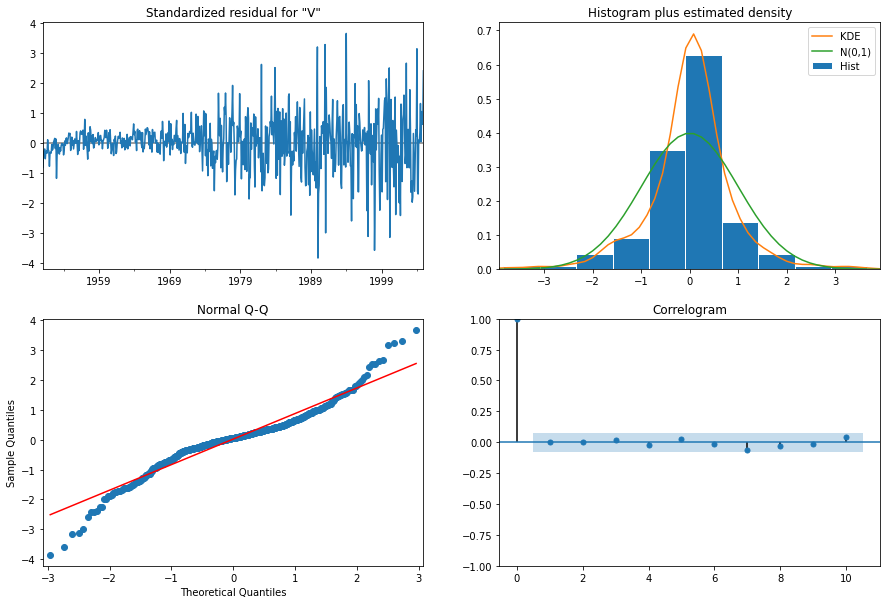

In [44]:

model_fit_raw.plot_diagnostics(figsize=(15,10))
plt.show()

<h4 style="color:#B40404;font-weight:bold">2<sup>nd</sup> model run with seasonal order </h4>

This model utilized a seasonal order with maximum p=5, d=1, q=2 and s=12. S was determined because it covers the regular patttern of the series happens every 12 months. The rest of the parameters were considered based on the reviewed literature :

<blockquote>Importantly, the order of differencing should not be too great. In general, the value of each parameter of an ARIMA(p, d, q) model should be kept as small as possible to avoid unwarranted complexity and overfitting to the sample data. As a not-at-all-universal rule of thumb, you should be quite skeptical of values of d over 2 and values of p and q over 5 or so. Also, you should expect either the p or q term to dominate and the other to be relatively small. These are practitioner notes gathered from analysts and not hard-and-fast mathematical truths.</blockquote>

Nielsen, Aileen.<i>Practical Time Series Analysis</i>, O'Reilly Media, Inc, October 2019

In [ ]:

p_param = 5 #0
d_param = 1 #1
q_param = 2 #1
s=12 #


model_raw_2 = SARIMAX(train2, seasonal_order=(p_param, d_param, q_param, s), trend="ct",freq='MS')
model_fit_raw_2 = model_raw_2.fit(disp=True)

model_fit_raw_2.summary()

In [ ]:
predictions_raw_2 = model_fit_raw_2.predict(start=0, end=len(train2)+len(test2)-1)

In [ ]:
two_thousand_raw2=model_fit_raw_2.forecast(steps=48)
two_thousand_raw2

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train2.index, y=train2, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test2.index, y=test2, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predictions_raw_2.index, y=predictions_raw_2, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Millions of Megawatts of Power Generated ", 
    xaxis_title="Date",
    title="Change in Revenue Passenger Miles over Prior Year"
)
fig.show()

This is a better prediction with a great imitation of the original data and it also repeats the past patterns, it only needs a little more tunnning of q.

<h5 style="color:#B40404;">Model Evaluation</h5>

In [ ]:
predictions = model_fit.predict(start=0, end=len(train2)+len(test2)-1)

train_mape = 100*mean_absolute_percentage_error(train2, predictions_raw_2[train2.index])
test_mape = 100*mean_absolute_percentage_error(test2, predictions_raw_2[test2.index])

print(f"Train MAPE on the difference: {round(train_mape, 2)}%")
print(f"Test MAPE on the difference: {round(test_mape, 2)}%")

In [ ]:
train_raw_MAE = mean_absolute_error(train2, predictions_raw_2[train2.index])
test_raw_MAE = mean_absolute_error(test2, predictions_raw_2[test2.index])

print(f"Train MAE on the difference: {round(train_raw_MAE, 2)}")
print(f"Test MAE on the difference: {round(test_raw_MAE, 2)}")

<h5 style="color:#515A5A"><i> Residuals Diagnostics</i></h5>

In [ ]:
fig = px.line(x=model_fit_raw.resid.index, y=model_fit_raw.resid)
fig.update_layout(
    yaxis_title="Residuals", 
    xaxis_title="Date",
    title="ARIMA model residuals"
)
fig
fig.show()

There is no clear pattern in the residuals and their mean is 0. Also we can appreciate it at the distribution in the histogram attached.

In [ ]:
model_fit.resid.plot(kind="hist")
plt.title("AR residuals")
plt.show()

In [ ]:
model_fit.resid.describe()

In [ ]:
plt.figure(figsize=(15, 5))
plot_acf(model_fit.resid, lags=58, ax=plt.gca())
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

It looks significant lags at 2,3,4,5,6,8

<h3><a style="color:#B40404;" id='three-three'><u>ARIMA on Log Transformed Data</a></u></h3>

Applying Logarithmic transformation to train and test data

In [ ]:
train_log=np.log(can_plain.loc[:'2003','VALUE'])
test_log=np.log(can_plain.loc['2003':,'VALUE'])

<h5 style="color:#B40404;"> Autocorrelation Function</h5>

In [ ]:
plt.figure(figsize=(15, 5))

# put the acf plot on the current axis
plot_acf(train_log, lags=48, ax=plt.gca()) #lags=58
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

<h5 style="color:#B40404;">Partial Autocorrelation</h5>

In [ ]:
plt.figure(figsize=(15, 5))

# put the acf plot on the current axis
plot_pacf(train_log, lags=48, ax=plt.gca()) #lags 58
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

<h5>ARIMA on Log transformed Data</h5>

In [ ]:
p_param = 1 #21 #12    #all possible significant lags from the partial autocorrelation function plot
d_param = 1   #0
q_param = 0 #15 #15       ##half lags from autocorrelation function plot

model_log = SARIMAX(train_log, order=(p_param, d_param, q_param), trend="ct")
model_log = model_log.fit(disp=False)

model_log.summary()

In [ ]:
predictions_log = model_log.predict(start=0, end=len(train2)+len(test2)-1)

In [ ]:
forecast_log=model_log.forecast(steps=12)
forecast_log

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train_log.index, y=train_log, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test_log.index, y=test_log, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predictions_log.index, y=predictions_log, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Total Electricity Generation in Megawatt-Hours", 
    xaxis_title="Date",
    title="Change in Electricity Generation over Prior Year"
)
fig.show()

In [ ]:
train_log_mape = 100*mean_absolute_percentage_error(train_log, predictions_log[train_log.index])
test_log_mape = 100*mean_absolute_percentage_error(test_log, predictions_log[test_log.index])

print(f"Train MAPE on the difference: {round(train_log_mape, 2)}%")
print(f"Test MAPE on the difference: {round(test_log_mape, 2)}%")

In [ ]:
train_log_MAE = mean_absolute_error(train_log, predictions_log[train_log.index])
test_log_MAE = mean_absolute_error(test_log, predictions_log[test_log.index])

print(f"Train MAE on the difference: {round(train_log_MAE, 2)}")
print(f"Test MAE on the difference: {round(test_log_MAE, 2)}")

<h2 style="color:#A802CA;font-weight:bold" >Reconstruction of Original signal</H2>

In [ ]:
first_date = train_log.index.min()

# create an empty restored column
can_plain["restored"] = np.nan

# fill in the first 12 original values from VALUE
can_plain.loc[first_date: first_date + pd.DateOffset(months=11), "restored"] = \
    can_plain.loc[first_date: first_date + pd.DateOffset(months=11), "VALUE"]

# use the current difference and 12-month lagged restored value to get the next restored
#restored = seasonal difference + restored
for date, val in can_plain.loc[first_date + pd.DateOffset(months=12):, "seasonal_difference"].items():
    can_plain.loc[date, "restored"] = can_plain.loc[date - pd.DateOffset(months=12), "restored"] + val

# check agreement everywhere (rounding errors can come up so check closeness rather than strict equality)
np.allclose(can_plain["VALUE"], can_plain["restored"])

In [ ]:
# use the original train diff values and predicted test values
can_plain.loc[train.index, "difference"] = can_plain.loc[train.index, "seasonal_difference"]
can_plain.loc[test.index, "difference"] = predictions[test.index]

# empty restored column
can_plain["signal_restored"] = np.nan

# fill in the first 12 original values
can_plain.loc[first_date: first_date + pd.DateOffset(months=11), "signal_restored"] = \
    can_plain.loc[first_date: first_date + pd.DateOffset(months=11), "VALUE"]

# use the current difference and 12-month lagged restored value to get the next restored
for date, val in can_plain.loc[first_date + pd.DateOffset(months=12):, "difference"].items():
    can_plain.loc[date, "signal_restored"] = \
        can_plain.loc[date - pd.DateOffset(months=12), "signal_restored"] + val

In [ ]:
can_plain.head(14)

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=can_plain.loc[train.index, "VALUE"], mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=can_plain.loc[test.index, "VALUE"], mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=test.index, y=can_plain.loc[test.index, "signal_restored"], mode='lines', name="prediction"))

fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Electicity generated in Millions of Megawatts", 
    xaxis_title="Date",
    title="Electricity Comparisson Real vs Reconstruction"
)
fig.show()

<h5> Residuals Diagnostics</h5>

In [ ]:
fig = px.line(x=model_log.resid.index, y=model_log.resid)
fig.update_layout(
    yaxis_title="Residuals", 
    xaxis_title="Date",
    title="ARIMA model residuals"
)
fig
fig.show()

There is no clear pattern in the residuals and their mean is 0. Also we can appreciate it at the distribution in the histogram attached.

In [ ]:
model_log.resid.plot(kind="hist")
plt.title("AR residuals")
plt.show()

In [ ]:
model_log.resid.describe()

In [ ]:
plt.figure(figsize=(15, 5))
plot_acf(model_log.resid, lags=48, ax=plt.gca())
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

No significant lags

<h3><a style="color:#4267B2;font-weight:bold" id='three-four'>Facebook Prophet</a></h3>

In [45]:

prophet_train = canada.loc[canada.index<= "2003-12-01", "VALUE"].reset_index()
prophet_train.rename(columns={"REF_DATE": "ds", "VALUE": "y"}, inplace=True)
prophet_train.head()

,ds,y
0,1950-01-01,4081000.0
1,1950-02-01,3780000.0
2,1950-03-01,4186000.0
3,1950-04-01,4070000.0
4,1950-05-01,4425000.0


In [66]:
model_prophet = Prophet(yearly_seasonality=1, seasonality_mode='multiplicative') #mcmc_samples=100
model_prophet.fit(prophet_train)

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [67]:
future = model_prophet.make_future_dataframe(periods=len(test)+48, freq="MS", include_history=False)
future

,ds
0,2004-01-01
1,2004-02-01
2,2004-03-01
3,2004-04-01
4,2004-05-01
...,...
68,2009-09-01
69,2009-10-01
70,2009-11-01
71,2009-12-01


In [68]:
future

,ds
0,2004-01-01
1,2004-02-01
2,2004-03-01
3,2004-04-01
4,2004-05-01
...,...
68,2009-09-01
69,2009-10-01
70,2009-11-01
71,2009-12-01


In [69]:
# Notice we need to provide a dataframe for the predict method, it must also contain a `ds` column
forecast = model_prophet.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
68,2009-09-01,4.878918e+07,4.663725e+07,5.110600e+07
69,2009-10-01,5.197788e+07,4.973188e+07,5.420262e+07
70,2009-11-01,5.532436e+07,5.310434e+07,5.753195e+07
71,2009-12-01,5.775735e+07,5.542136e+07,6.005151e+07
72,2010-01-01,5.877019e+07,5.660123e+07,6.105167e+07


In [70]:
from fbprophet.plot import plot_plotly

fig = plot_plotly(model_prophet, forecast) # returns a plotly Figure object
fig.show()

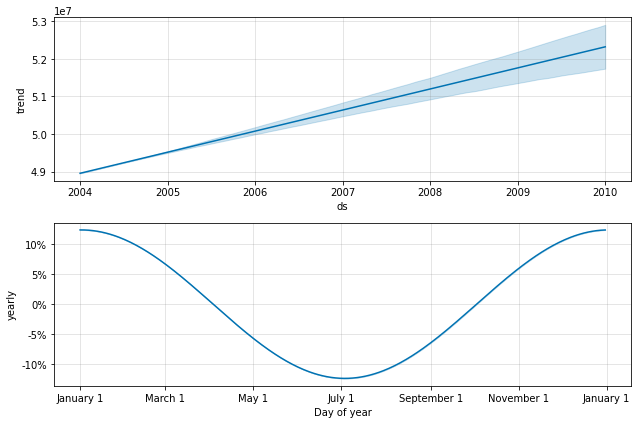

In [71]:
fig = model_prophet.plot_components(forecast)

In [72]:
prophet_train.shape

(648, 2)

In [73]:
forecast.shape

(73, 16)

In [74]:
prophet_train.tail()

,ds,y
643,2003-08-01,45425311.0
644,2003-09-01,40298546.0
645,2003-10-01,42966467.0
646,2003-11-01,46468433.0
647,2003-12-01,52222674.0


In [75]:
forecast[['ds','yhat_lower','yhat_upper','yhat']]

,ds,yhat_lower,yhat_upper,yhat
0,2004-01-01,5.291071e+07,5.700956e+07,5.498567e+07
1,2004-02-01,5.226022e+07,5.656253e+07,5.428814e+07
2,2004-03-01,5.022269e+07,5.450645e+07,5.229380e+07
3,2004-04-01,4.711565e+07,5.139755e+07,4.929874e+07
4,2004-05-01,4.423698e+07,4.860298e+07,4.633138e+07
...,...,...,...,...
68,2009-09-01,4.663725e+07,5.110600e+07,4.878918e+07
69,2009-10-01,4.973188e+07,5.420262e+07,5.197788e+07
70,2009-11-01,5.310434e+07,5.753195e+07,5.532436e+07
71,2009-12-01,5.542136e+07,6.005151e+07,5.775735e+07


In [76]:
df_merge = pd.merge(prophet_train, forecast[['ds','yhat_lower','yhat_upper','yhat']],on='ds')
df_merge

,ds,y,yhat_lower,yhat_upper,yhat


In [77]:
y_true = df_merge['y'].values
y_pred = df_merge['yhat'].values
mae_01 = mean_absolute_error(y_true, y_pred)
mape_01 = mean_absolute_percentage_error(y_true, y_pred)

ValueError: ignored

<a href='https://facebook.github.io/prophet/docs/diagnostics.html#hyperparameter-tuning'> Documentation</a>

Electricity 
Gorse, Christopher Johnston, David Pritchard, Martin. (2012). Dictionary of Construction, Surveying and Civil Engineering - electric power. (pp. 132). Oxford University Press. Retrieved from
https://app.knovel.com/hotlink/pdf/id:kt00C1GZJ1/dictionary-construction/electric-power

<a href='https://energi.media/news/how-the-2021-summer-heat-dome-affected-electricity-demand-in-western-canada/'>How the 2021 summer heat dome affected electricity demand in western Canada</a>